# Find the optimum Rotation of CTIO Data in May 2017
==================================================================================================

- author : Sylvie Dagoret-Campagne et Jérémy Neveu
- affiliation : LAL/IN2P3/CNRS, France
- date   : May 29th 2017
- update : May 07st 2017


- The goal is to rotate the image correctly such the dispersive axis must be parallel to X.
Carefull check must be done with eye such the fit of the Y vs X line is correct without bias.
This can be done on every image. Another solution is to force the value of the rotation angle
if one is sure of it.
- So One must decide if he want one average rotation angle or one rotation angle for each image.
Not sure.
- An Hessian method used to detect filaments in maps has been adapted to detect the spectra and 
compute their rotation angles

In [64]:
#%%javascript
#var kernel = IPython.notebook.kernel;
#var thename = window.document.getElementById("notebook_name").innerHTML;
#var command = "theNotebook = " + "'"+thename+"'";
#kernel.execute(command);

In [65]:
#print theNotebook

In [66]:
theNotebook="FindOptRot"

In [67]:
%matplotlib inline
%matplotlib inline
%load_ext autoreload
%autoreload 2
import matplotlib.pyplot as plt
import numpy as np
import math as m

from astropy.modeling import models
from astropy import units as u
from astropy import nddata
from astropy.io import fits
import re
import os, sys
sys.path.append('../../common_tools')
from scan_holo import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [68]:
import ccdproc
print 'ccdproc version',ccdproc.__version__

from astropy.modeling import models

ccdproc version 1.0.1


In [69]:
from scipy import stats  
from scipy import ndimage
from datetime import datetime, timedelta
from mpl_toolkits.mplot3d import Axes3D
import scipy.signal
from matplotlib import cm

In [70]:
import bottleneck as bn  # numpy's masked median is slow...really slow (in version 1.8.1 and lower)
print 'bottleneck version',bn.__version__

bottleneck version 1.2.0


In [71]:
import photutils
from astropy.stats import sigma_clipped_stats
from photutils import daofind
from photutils import CircularAperture
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
#from photutils.background import Background2D
from photutils import Background2D, SigmaClip, MedianBackground

In [72]:
%load_ext Cython

The Cython extension is already loaded. To reload it, use:
  %reload_ext Cython


In [73]:
from IPython.display import Image, display

In [74]:
import matplotlib
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 

In [75]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (15, 15),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [76]:
############################################################################
def ensure_dir(f):
    d = os.path.dirname(f)
    if not os.path.exists(f):
        os.makedirs(f)
#########################################################################

### Output directory for images generated in the notebook view (not true fits images)

In [77]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images

In [78]:
ensure_dir(dir_top_images) # create that directory

### input directory of fits images

In [79]:
inputdir="cut_fitsimages"
MIN_IMGNUMBER=58
MAX_IMGNUMBER=199
object_name='HD111980 May 30th'
SelectTagRe='^cutimg_20170530_([0-9]+).fits$' # regular expression to select the file
SearchTagRe='^cutimg_20170530_[0-9]+.fits$'
NBIMGPERROW=4
BigFigSize=(20,100)

### output directory of fits images

In [80]:
outputdir="./rotated_fitsimages"

In [81]:
ensure_dir(outputdir)

## Location of corrected images
----------------------------------

In [82]:
input_filelist=os.listdir(inputdir) 

In [83]:
if '.DS_Store' in input_filelist:
    input_filelist.remove('.DS_Store')
input_filelist=np.array(input_filelist)

In [84]:
print input_filelist

['cutimg_20170530_059.fits' 'cutimg_20170530_060.fits'
 'cutimg_20170530_061.fits' 'cutimg_20170530_062.fits'
 'cutimg_20170530_063.fits' 'cutimg_20170530_064.fits'
 'cutimg_20170530_065.fits' 'cutimg_20170530_066.fits'
 'cutimg_20170530_067.fits' 'cutimg_20170530_068.fits'
 'cutimg_20170530_069.fits' 'cutimg_20170530_070.fits'
 'cutimg_20170530_071.fits' 'cutimg_20170530_072.fits'
 'cutimg_20170530_073.fits' 'cutimg_20170530_074.fits'
 'cutimg_20170530_075.fits' 'cutimg_20170530_076.fits'
 'cutimg_20170530_077.fits' 'cutimg_20170530_078.fits'
 'cutimg_20170530_079.fits' 'cutimg_20170530_080.fits'
 'cutimg_20170530_081.fits' 'cutimg_20170530_082.fits'
 'cutimg_20170530_083.fits' 'cutimg_20170530_084.fits'
 'cutimg_20170530_085.fits' 'cutimg_20170530_086.fits'
 'cutimg_20170530_087.fits' 'cutimg_20170530_088.fits'
 'cutimg_20170530_089.fits' 'cutimg_20170530_090.fits'
 'cutimg_20170530_091.fits' 'cutimg_20170530_092.fits'
 'cutimg_20170530_093.fits' 'cutimg_20170530_094.fits'
 'cutimg_2

In [85]:
indexes_files= [] # global list
filelist_fitsimages= []  # global list

In [86]:
#%%cython

import numpy as np
import re

def MakeFileList(inputdir,input_filelist):
    """
    MakeFileList : Make The List of files to open
    =============
    """
    
#    import numpy as np
#    import re
    indexes_files= [] # global list
    filelist_fitsimages= []  # global list
    

    
    for file in input_filelist: # loop on directories, one per image       
            filename=inputdir+'/'+file
            if re.search('.*fits$',filename):  #example of filename filter
                num_str=re.findall(SelectTagRe,file)[0]
                index=int(num_str)
                filelist_fitsimages.append(filename)
                indexes_files.append(index)
    return indexes_files, filelist_fitsimages


In [87]:
indexes_files, filelist_fitsimages=MakeFileList(inputdir,input_filelist)   # Make the list

In [88]:
indexes_files=np.array(indexes_files)
filelist_fitsimages=np.array(filelist_fitsimages)

In [89]:
print indexes_files

[ 59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112
 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130
 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148
 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184
 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199]


In [90]:
sorted_indexes=np.argsort(indexes_files) # sort the file indexes

In [91]:
sorted_numbers=indexes_files[sorted_indexes]

In [92]:
print sorted_indexes

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140]


In [93]:
#sorted_files= [filelist_fitsimages[index] for index in sorted_indexes] # sort files
sorted_files=filelist_fitsimages[sorted_indexes]

In [94]:
#sorted_files

## Build full filename
----------------------------

In [95]:
sorted_filenames=[]
for file in sorted_files:
    #fullfilename=os.path.join(inputdir,file)
    fullfilename=file
    sorted_filenames.append(fullfilename)

In [96]:
#sorted_filenames=np.array(sorted_filenames)
sorted_filenames=np.copy(sorted_files)

In [97]:
print sorted_filenames.shape

(141,)


## Acces to data of  images
----------------------------------

In [98]:
all_dates = []
all_airmass = []
all_images = []
all_titles = []
all_header = []
all_img = []
all_filt = []

In [99]:
%%cython

import numpy as np
from astropy.io import fits

def BuildImages(sorted_filenames,sorted_numbers,object_name):
    """
    BuildRawImages
    ===============
    """

    
    all_dates = []
    all_airmass = []
    all_images = []
    all_titles = []
    all_header = []
    all_expo = []
    all_filt = []
   
    NBFILES=sorted_filenames.shape[0]

    for idx in range(NBFILES):  
        
        file=sorted_filenames[idx]    
        
        hdu_list=fits.open(file)
        header=hdu_list[0].header
        #print header
        date_obs = header['DATE-OBS']
        airmass = header['AIRMASS']
        expo = header['EXPTIME']
        filters = header['FILTERS']
        num=sorted_numbers[idx]
        title=object_name+" z= {:3.2f} Nb={}".format(float(airmass),num)
        image_corr=hdu_list[0].data
        image=image_corr
        
        all_dates.append(date_obs)
        all_airmass.append(float(airmass))
        all_images.append(image)
        all_titles.append(title)
        all_header.append(header)
        all_expo.append(expo)
        all_filt.append(filters)
        hdu_list.close()
        
    return all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt

In [100]:
all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

## Show images
-----------------------

In [101]:
len(all_images)

141

In [102]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import os
import math as m
global NBIMGPERROW
    
def ShowImages(all_images,all_titles,object_name,dir_top_images):
    """
    ShowRawImages: Show the raw images without background subtraction
    ==============
    """
    NBIMGPERROW=4
    NBIMAGES=len(all_images)
    #MAXIMGROW=int(NBIMAGES/NBIMGPERROW)+1
    MAXIMGROW=max(2,int(m.ceil(float(NBIMAGES)/float(NBIMGPERROW))))

    thex0 = []
    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,3*MAXIMGROW))
    for index in np.arange(0,NBIMAGES):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        xprofile=np.sum(all_images[index],axis=0)
        x0=np.where(xprofile==xprofile.max())[0][0]
        thex0.append(x0)
        im=axarr[iy,ix].imshow(all_images[index],origin='lower',cmap='rainbow',vmin=-10,vmax=800)
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(color='white', ls='solid')
    title='Images of {}'.format(object_name)
    plt.suptitle(title,size=16)
    figfilename=os.path.join(dir_top_images,'input_images.pdf')
    plt.savefig(figfilename)  
    return thex0

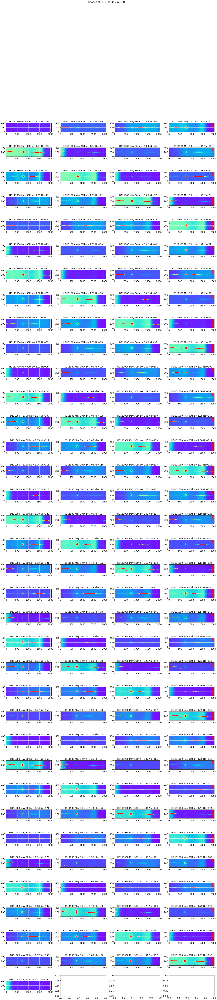

In [103]:
thex0=ShowImages(all_images,all_titles,object_name,dir_top_images)

## Duplicate the images

In [104]:
all_images2=[]
for image in all_images:
    image_copy=np.copy(image)
    all_images2.append(image_copy)

## Subtract Background

In [105]:
for theimage in all_images2:
    NR,NC=theimage.shape
    EmptySkyBackground=np.zeros([NR,NC])
    SkyBackground=EmptySkyBackground+np.median(theimage,axis=0)
    theimage-=SkyBackground

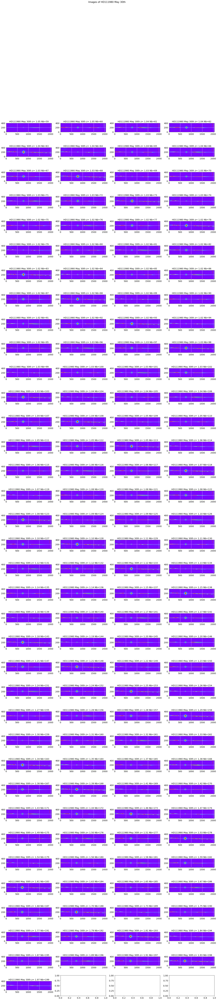

In [106]:
thex02=ShowImages(all_images2,all_titles,object_name,dir_top_images)

### Shows the transverse profile

In [107]:
DeltaX=600
w=20
ws=80

In [ ]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import math as m    
import os


def ShowTransverseProfile(all_images,all_titles,object_name,all_expo,dir_top_images):
    """
    ShowTransverseProfile: Show the raw images without background subtraction
    =====================
    """
    NBIMGPERROW=4
    NBIMAGES=len(all_images)
    #MAXIMGROW=int(NBIMAGES/NBIMGPERROW)+1
    MAXIMGROW=max(2,int(m.ceil(float(NBIMAGES)/float(NBIMGPERROW))))
    DeltaX=600
    w=20
    ws=80
    thespectra= []
    they0= []
    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,4*MAXIMGROW))
    for index in np.arange(0,NBIMAGES):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        data=np.copy(all_images[index])
        data[:,DeltaX-ws:DeltaX+ws]=0
        if(all_expo[index]<=0):
            yprofile=np.sum(data,axis=1)  #very special case
        else:
            yprofile=np.sum(data,axis=1)/all_expo[index]
        ymin=1
        ymax=yprofile.max()
        y0=np.where(yprofile==ymax)[0][0]
        they0.append(y0)
        #im=axarr[iy,ix].imshow(data,vmin=-10,vmax=50)
        axarr[iy,ix].semilogy(yprofile)
        axarr[iy,ix].semilogy([y0,y0],[ymin,ymax],'r-')
        axarr[iy,ix].semilogy([y0-w,y0-w],[ymin,ymax],'k-')
        axarr[iy,ix].semilogy([y0+w,y0+w],[ymin,ymax],'k-')
        axarr[iy,ix].set_ylim(1000.,2e5)
        spectrum2D=np.copy(data[y0-w:y0+w,:])
        xprofile=np.sum(spectrum2D,axis=0)
        thespectra.append(xprofile/(2.*float(w))/all_expo[index])
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
    title='Spectrum tranverse profile '.format(object_name)
    plt.suptitle(title,size=16)
    figfilename=os.path.join(dir_top_images,'transverse_profile.pdf')
    plt.savefig(figfilename)  
    return thespectra,they0

In [ ]:
thespectra,they0=ShowTransverseProfile(all_images2,all_titles,object_name,all_expo,dir_top_images)

In [110]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import os
def ShowSpectrumProfile(spectra,all_titles,object_name,dir_top_images):
    """
    ShowSpectrumProfile: Show the raw images without background subtraction
    =====================
    """
    NBIMGPERROW=4
    NBSPEC=len(spectra)
    #MAXIMGROW=int(NBSPEC/NBIMGPERROW)+1
    MAXIMGROW=max(2,int(m.ceil(float(NBIMAGES)/float(NBIMGPERROW))))
    
    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,4*MAXIMGROW))
    for index in np.arange(0,NBSPEC):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        axarr[iy,ix].plot(spectra[index])
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
        axarr[iy,ix].set_ylim(0.,200.)
    title='Spectrum 1D profile '.format(object_name)
    figfilename=os.path.join(dir_top_images,'longitudinal_profile.pdf')
    plt.savefig(figfilename)  
    plt.suptitle(title,size=16)

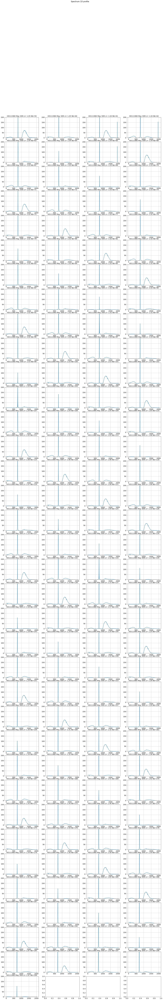

In [111]:
ShowSpectrumProfile(thespectra,all_titles,object_name,dir_top_images)

In [112]:
print they0

[196, 205, 195, 207, 185, 199, 205, 195, 208, 185, 200, 205, 195, 207, 186, 200, 205, 195, 207, 187, 200, 205, 194, 207, 185, 200, 205, 194, 206, 185, 200, 205, 194, 207, 185, 200, 205, 194, 207, 185, 200, 205, 194, 207, 185, 200, 205, 194, 208, 184, 200, 205, 194, 207, 184, 200, 205, 194, 207, 184, 200, 206, 194, 207, 186, 200, 205, 194, 206, 184, 200, 205, 194, 207, 186, 200, 206, 194, 207, 185, 200, 205, 194, 207, 186, 200, 206, 194, 207, 185, 200, 205, 194, 207, 186, 200, 206, 195, 207, 185, 200, 205, 194, 192, 185, 200, 204, 195, 192, 187, 200, 206, 194, 192, 185, 200, 205, 194, 191, 186, 200, 204, 195, 207, 185, 200, 205, 195, 191, 184, 200, 206, 195, 191, 186, 200, 206, 195, 192, 200, 200]


In [113]:
print thex0

[778, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958, 1958]


### Test rotation optimum
----------------------------

In [114]:
from scipy import stats 
from scipy import ndimage
from scipy.optimize import curve_fit

In [115]:
sel=0

In [116]:
image_sel=np.copy(all_images2[sel])
y0=they0[sel]
x0=thex0[sel]

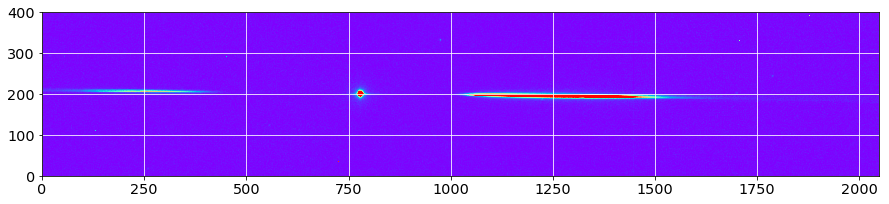

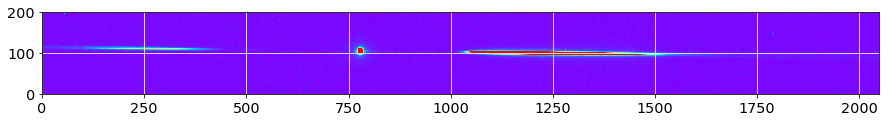

In [117]:
width_cut = 100

plt.imshow(image_sel,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

region=np.copy(image_sel[y0-width_cut:y0+width_cut,:])
data=np.copy(region)
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

### find the orientation by the average

In [118]:
def ComputeMedY(data):
    """
    Compute the median of Y vs X to find later the angle of rotation
    """
    NBINSY=data.shape[0]
    NBINSX=data.shape[1]
    the_medianY=np.zeros(NBINSX)
    the_y=np.zeros(NBINSY)
    for ix in np.arange(NBINSX):
        the_ysum=np.sum(data[:,ix])
        for iy in np.arange(NBINSY):
            the_y[iy]=iy*data[iy,ix]
        if(the_ysum>0):
            med=np.sum(the_y)/the_ysum
            the_medianY[ix]=med
    return the_medianY

In [119]:
def ComputeAveY(data):
    """
    Compute the average of Y vs X to find later the angle of rotation
    """
    NBINSY=data.shape[0]
    NBINSX=data.shape[1]
    the_averY=np.zeros(NBINSX)
    the_y=np.zeros(NBINSY)
    for ix in np.arange(NBINSX):
        the_ysum=np.sum(data[:,ix])
        for iy in np.arange(NBINSY):
            the_y[iy]=iy*data[iy,ix]
        if(the_ysum>0):
            med=np.sum(the_y)/the_ysum
            the_averY[ix]=med
    return the_averY

In [120]:

xindex=np.arange(data.shape[1])

In [121]:
#selected_indexes=np.where(np.logical_or(xindex<480,xindex>1100))

In [122]:
#selected_indexes=np.where(np.logical_or(np.logical_and(xindex>100,xindex<200) ,np.logical_and(xindex>1410,xindex<1600)))

In [123]:
selected_indexes=np.where(np.logical_or(np.logical_and(xindex>0,xindex<200) ,np.logical_and(xindex>750,xindex<1600)))

In [124]:
yaver=ComputeAveY(data)

In [125]:
XtoFit=np.array(xindex[selected_indexes])
YtoFit=np.array(yaver[selected_indexes])

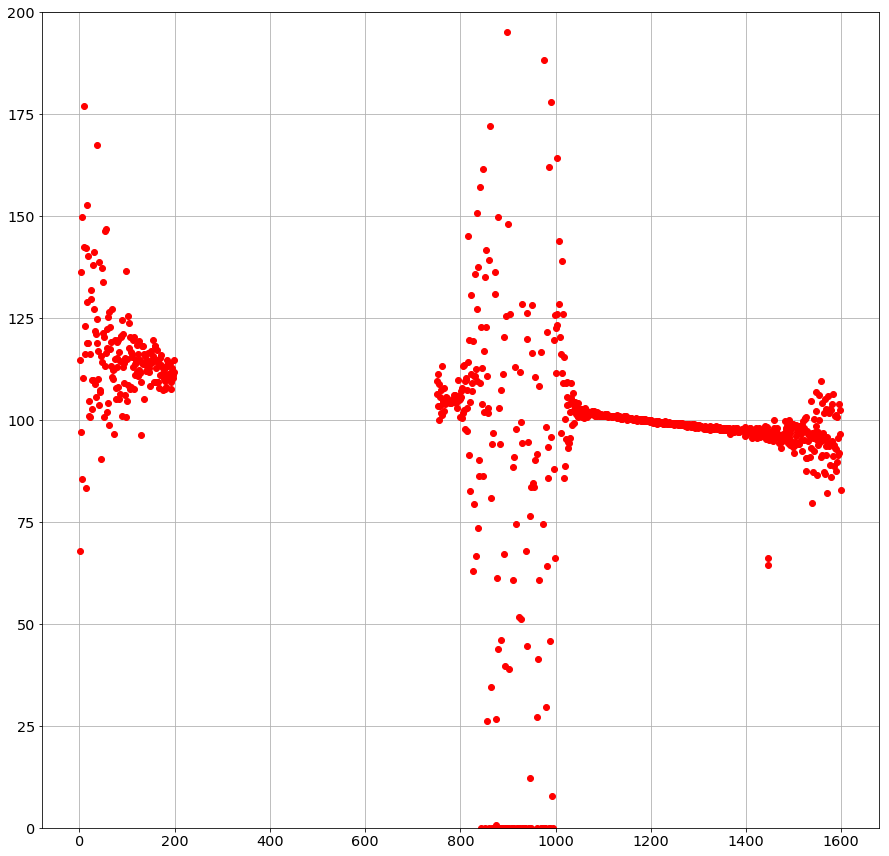

In [126]:
plt.plot(XtoFit,YtoFit,'ro')
plt.ylim(0,200)
plt.grid(True)

In [127]:
selected_indexes2=np.where(np.logical_and(YtoFit<200,YtoFit>0))

In [128]:
XtoFit2=XtoFit[selected_indexes2]
YtoFit2=YtoFit[selected_indexes2]

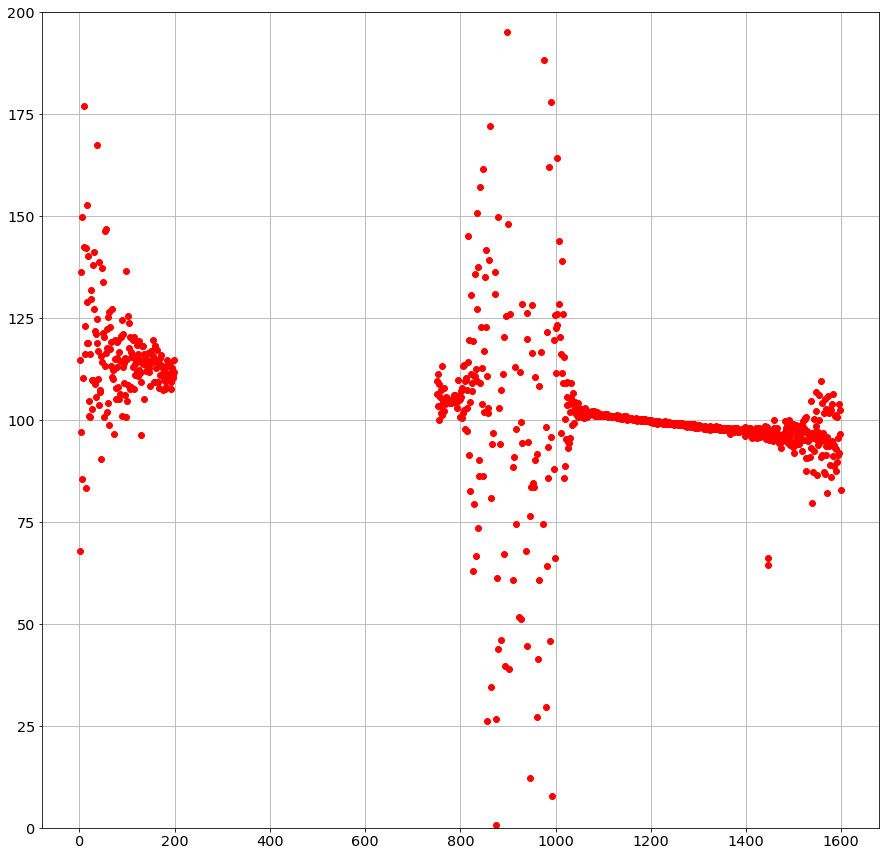

In [129]:
plt.plot(XtoFit2,YtoFit2,'ro')
plt.ylim(0,200)
plt.grid(True)

In [130]:
def fit_func(x, a, b):
    return a*x + b

In [131]:
from scipy.optimize import curve_fit
   

In [132]:
params = curve_fit(fit_func, XtoFit2, YtoFit2)
[a, b] = params[0]

In [133]:
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = fit_func(x_new,a,b)

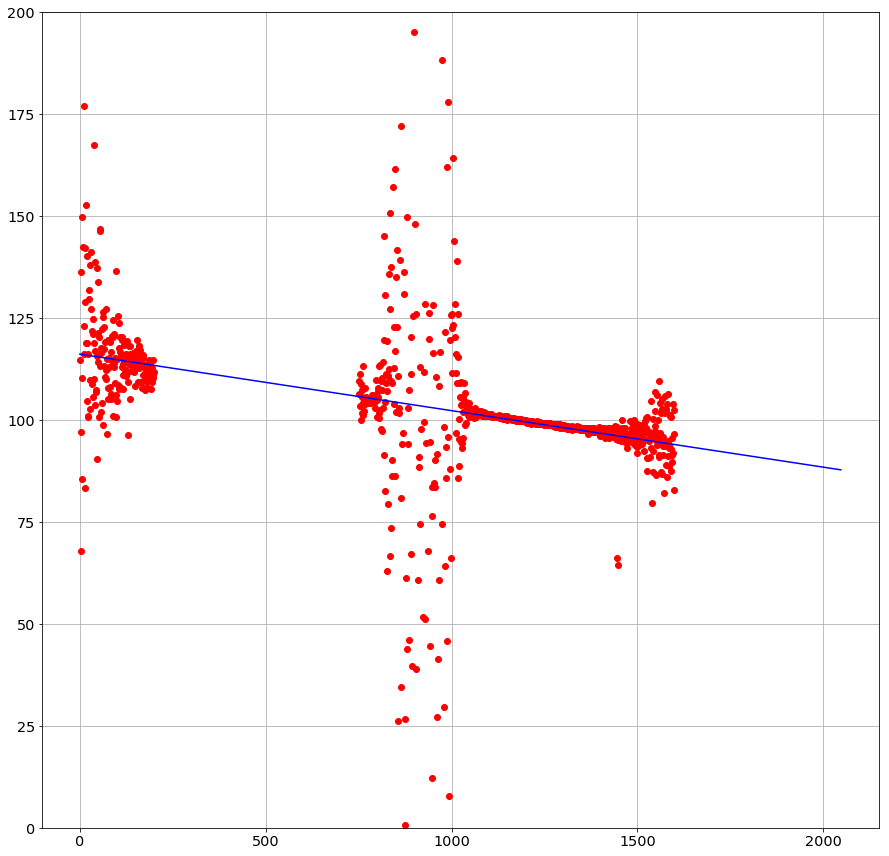

In [134]:
plt.plot(XtoFit2,YtoFit2,'ro')
plt.plot(x_new,y_new,'b-')
plt.ylim(0,200)
plt.grid(True)

In [135]:
print a,b

-0.0138636075386 116.183952494


In [136]:
print np.arctan(a)*180/np.pi

-0.794275316923


### Find rotation by Hessian analysis

La méthode s'inspire des techniques de détection de filmanents dans le milieu interstellaire.
Elle est décrite dans https://arxiv.org/pdf/1409.6728.pdf section 4.1.
Documentation sur le calcul du Hessien : http://scikit-image.org/docs/dev/api/skimage.feature.html#skimage.feature.hessian_matrix

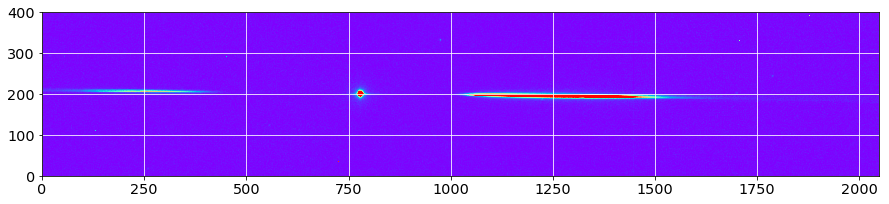

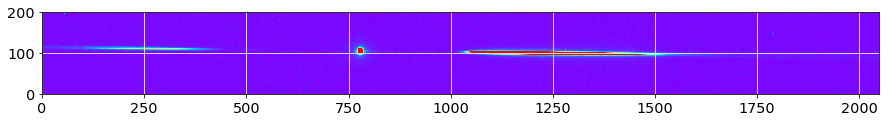

In [137]:
width_cut = 100

plt.imshow(image_sel,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

region=np.copy(image_sel[y0-width_cut:y0+width_cut,:])
data=np.copy(region)
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

In [138]:
from skimage.feature import hessian_matrix
# le paramètre sigma permet de lisser le hessien
Hxx, Hxy, Hyy = hessian_matrix(data, sigma=3, order = 'xy')
lambda_plus = 0.5*( (Hxx+Hyy) + np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
lambda_minus = 0.5*( (Hxx+Hyy) - np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
theta = 0.5*np.arctan2(2*Hxy,Hyy-Hxx)*180/np.pi

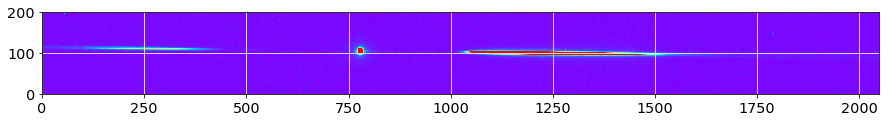

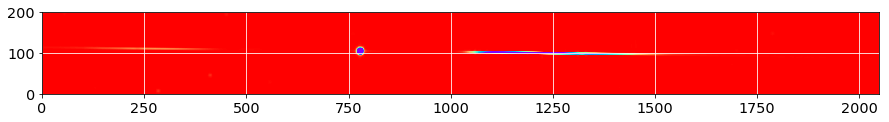

In [139]:
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()
plt.imshow(lambda_minus,origin='lower',cmap='rainbow',vmin=-100,vmax=0)
plt.grid(color='white', ls='solid')
plt.show()

Maintenant on va sélectionner le spectre à l'aide d'un seuil pour éliminer le fond.

Number of remaining pixels : 2999


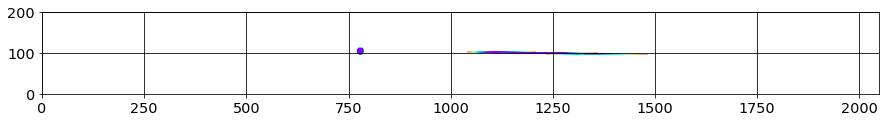

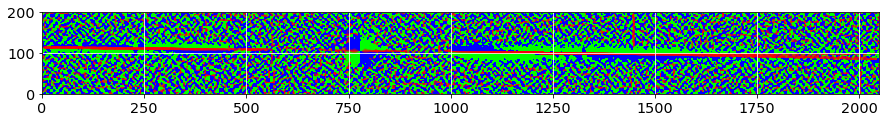

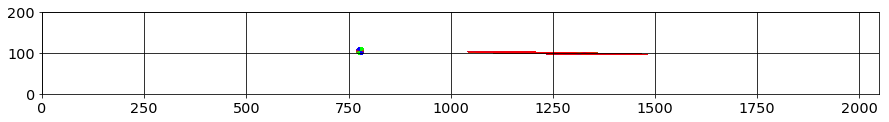

In [140]:
lambda_threshold = -20  

mask = np.where(lambda_minus>lambda_threshold)
lambda_mask = np.copy(lambda_minus)
lambda_mask[mask]=np.nan

theta_mask = np.copy(theta)
theta_mask[mask]=np.nan

print 'Number of remaining pixels :',len(lambda_mask[~np.isnan(lambda_mask)])

plt.imshow(lambda_mask,origin='lower',cmap='rainbow',vmin=-100,vmax=0)
plt.grid(color='black', ls='solid')
plt.show()

plt.imshow(theta,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='white', ls='solid')
plt.show()

plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='black', ls='solid')
plt.show()

On sait que l'angle que l'on recherche est petit car l'axe de dispersion du réseau est bien aligné selon x, donc on peut sélectionner.

Number of remaining pixels : 2643


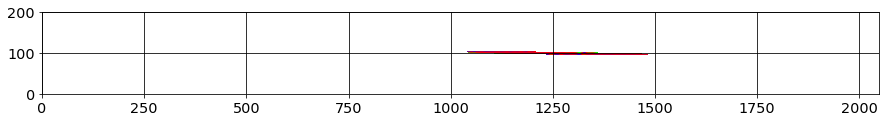

In [141]:
deg_threshold = 8

mask2 = np.where(np.abs(theta)>deg_threshold)
theta_mask[mask2] = np.nan
print 'Number of remaining pixels :',len(theta_mask[~np.isnan(theta_mask)])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.grid(color='black', ls='solid')
plt.show()

Angle median : -0.814073371224


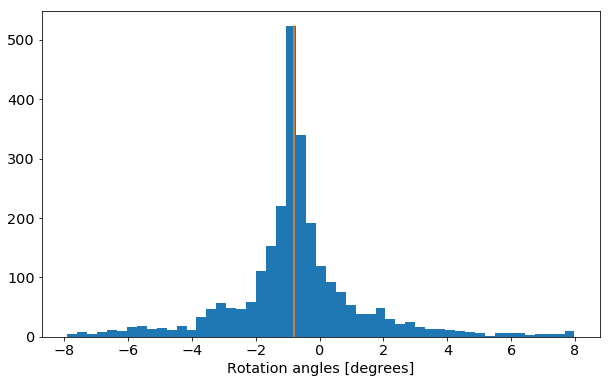

In [142]:
theta_hist = []
theta_hist = theta_mask[~np.isnan(theta_mask)].flatten()
theta_median = np.median(theta_hist)
print 'Angle median :',theta_median
fig = plt.figure(figsize=(10,6))
n,bins, patches = plt.hist(theta_hist,bins=int(np.sqrt(len(theta_hist))))
plt.plot([theta_median,theta_median],[0,np.max(n)])
plt.xlabel("Rotation angles [degrees]")
plt.show()

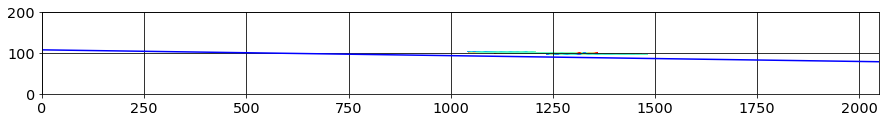

In [143]:
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = y0 - width_cut + (x_new-x0)*np.tan(theta_median*np.pi/180.)
plt.imshow(theta_mask,origin='lower',cmap='rainbow',vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()

On peut aussi essayer de fitter le spectre qui a été détecté par la méthode ci-dessus.

Rotation angle from fit : -0.728745022309


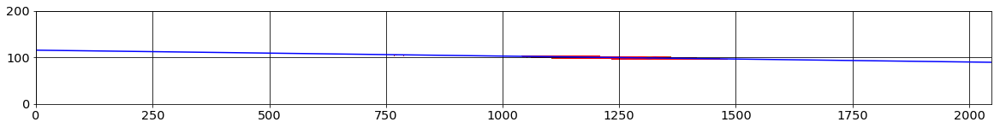

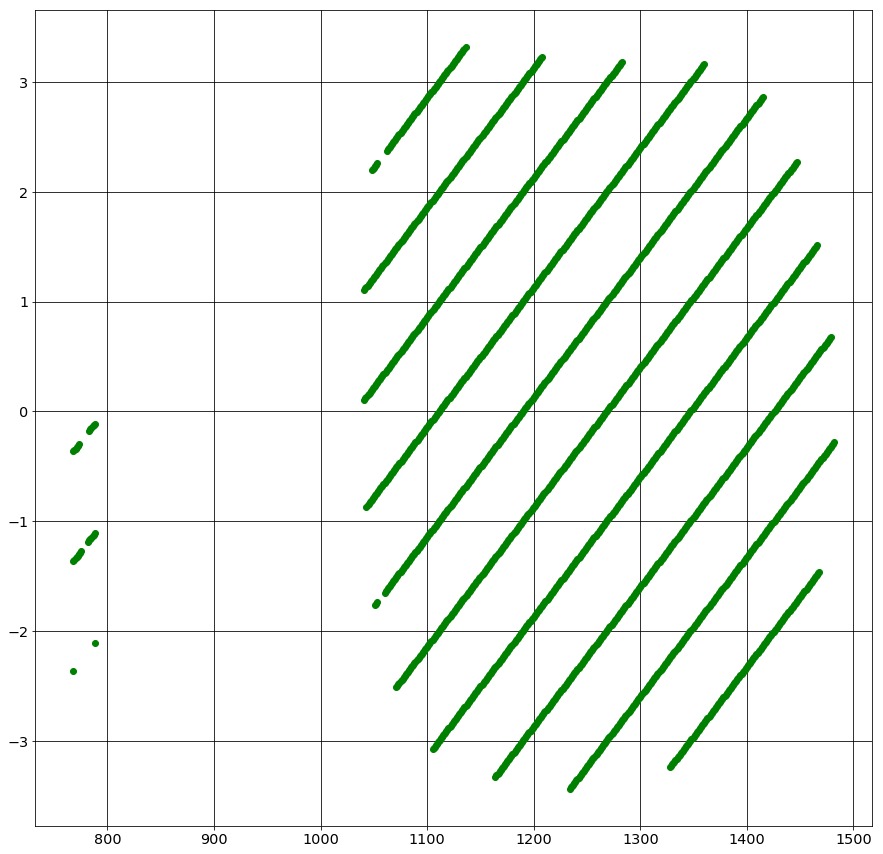

In [144]:
xtofit=[]
ytofit=[]
for iy,y in enumerate(theta_mask):
    for ix,x in enumerate(y):
        if not np.isnan(theta_mask[iy][ix]) :
            if np.abs(theta_mask[iy][ix])>12 : continue
            xtofit.append(ix)
            ytofit.append(iy)
params = curve_fit(fit_func, xtofit, ytofit)
[a, b] = params[0]
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = fit_func(x_new,a,b)
print 'Rotation angle from fit :',np.arctan(a)*180/np.pi
fig = plt.figure(figsize=[20,30])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()
diff = []
for ix,x in enumerate(xtofit):
    diff.append(ytofit[ix]-fit_func(x,a,b))
plt.plot(xtofit,diff,'go')
plt.grid(color='black', ls='solid')
plt.show()

Je pense que la méthode de fit est plus compliquée dans un champ encombré.

## Find Rotation angle for each image
----------------------------------------------

In [145]:
def ComputeRotationAngle(all_images,thex0,they0,all_titles,object_name):
    """
    ComputeRotationAngle
    ====================
    
    input:
    ------
    all_images
    thex0
    they0
    
    
    output:
    ------
    param_a
    param_b
    
    """
    NBIMAGES=len(all_images)
    MAXIMGROW=int(NBIMAGES/NBIMGPERROW)+1
    
    param_a=np.zeros(NBIMAGES)
    param_b=np.zeros(NBIMAGES)

    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,4*MAXIMGROW))
    for index in np.arange(0,NBIMAGES):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        
        image=all_images[index]    
        
        image_sel=np.copy(image)
        y0=they0[index]
        x0=thex0[index]
        
        # extract a region of 200 x 1000 centered at y=100,x=500
        
        region=np.copy(image_sel[y0-100:y0+100,:])
        data=np.copy(region)
        
        xindex=np.arange(data.shape[1])
        
        #selected_indexes=np.where(np.logical_or(np.logical_and(xindex>100,xindex<200) ,np.logical_and(xindex>1410,xindex<1600))) 
        selected_indexes=np.where(np.logical_or(np.logical_and(xindex>0,xindex<150) ,np.logical_and(xindex>1500,xindex<1600)))
        # compute Y vs X
        yaver=ComputeAveY(data)
        
        XtoFit=xindex[selected_indexes]
        YtoFit=yaver[selected_indexes]
        # does the fit
        params = curve_fit(fit_func, XtoFit, YtoFit)
        [a, b] = params[0]
        
        param_a[index]=a
        param_b[index]=b
        
        print index,' y = ',a,' * x + ',b
        x_new = np.linspace(xindex.min(),xindex.max(), 50)
        y_new = fit_func(x_new,a,b)
    
        im=axarr[iy,ix].plot(XtoFit,YtoFit,'ro')
        im=axarr[iy,ix].plot(x_new,y_new,'b-')
        axarr[iy,ix].set_title(all_titles[index])
        
        axarr[iy,ix].set_ylim(0,200)
        axarr[iy,ix].grid(True)
        
    title='Fit rotation angle of '.format(object_name)    
    plt.suptitle(title,size=16)
    
    figfilename=os.path.join(dir_top_images,'fit_rotation.pdf')
    plt.savefig(figfilename)  
    
    
    return param_a,param_b
    
    

0  y =  -0.0193715935189  * x +  126.338887591
1  y =  -0.010054413272  * x +  102.308703491
2  y =  -0.0105415504721  * x +  114.275934915
3  y =  -0.0182869866591  * x +  108.947400288
4  y =  -0.0379858724178  * x +  148.785696615
5  y =  -0.0428842326953  * x +  138.406297171
6  y =  -0.0106376566194  * x +  102.344344181
7  y =  -0.0105091690595  * x +  113.996855514
8  y =  -0.0182109350929  * x +  108.226930848
9  y =  -0.0389387448888  * x +  148.843274221
10  y =  -0.0431757008362  * x +  137.232307812
11  y =  -0.0111930051335  * x +  103.645216418
12  y =  -0.0111272277472  * x +  115.628106828
13  y =  -0.0188246707406  * x +  109.363428854
14  y =  -0.0381614924589  * x +  147.182137513
15  y =  -0.0419126768536  * x +  136.331930806
16  y =  -0.00609717710204  * x +  96.083452591
17  y =  -0.0112441688616  * x +  114.645463063
18  y =  -0.0179508516521  * x +  107.592930952
19  y =  -0.0370226021362  * x +  145.017125714
20  y =  -0.0428535794583  * x +  136.989592963
21 

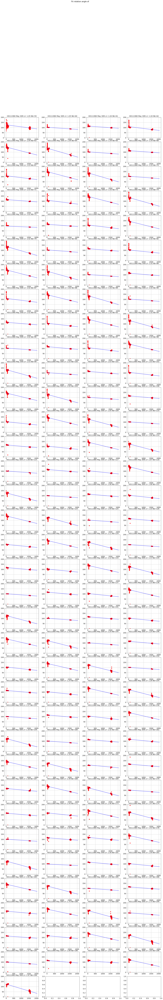

In [146]:
all_a,all_b=ComputeRotationAngle(all_images2,thex0,they0,all_titles,object_name)

In [147]:
all_angles=np.arctan(all_a)*180./np.pi

In [148]:
def ComputeRotationAngleHessian(all_images,thex0,they0,all_titles,object_name):
    """
    ComputeRotationAngle
    ====================
    
    input:
    ------
    all_images
    thex0
    they0
    all_titles
    object_name
    
    output:
    ------
    rotation angles
    
    """
    NBIMAGES=len(all_images)
    NBIMGPERROW=2
    MAXIMGROW=int(NBIMAGES/NBIMGPERROW)+1
    
    
    param_theta=np.zeros(NBIMAGES)
    
    ####### PARAMETERS TO BE TUNED #########
    lambda_threshold = -20
    deg_threshold = 8
    width_cut = 100
    ########################################

    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,2*MAXIMGROW))
    for index in np.arange(0,NBIMAGES):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        
        image=all_images[index]    
        
        image_sel=np.copy(image)
        y0=they0[index]
        x0=thex0[index]
        
        # extract a region of 200 x 1000 centered at y=100,x=500
        
        region=np.copy(image_sel[y0-width_cut:y0+width_cut,:])
        data=np.copy(region)
        
        # compute hessian matrices on the image
        
        Hxx, Hxy, Hyy = hessian_matrix(data, sigma=3, order = 'xy')
        lambda_plus = 0.5*( (Hxx+Hyy) + np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
        lambda_minus = 0.5*( (Hxx+Hyy) - np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
                

        mask = np.where(lambda_minus>lambda_threshold)
        #lambda_mask = np.copy(lambda_minus)
        #lambda_mask[mask]=np.nan

        theta = 0.5*np.arctan2(2*Hxy,Hyy-Hxx)*180/np.pi
        theta_mask = np.copy(theta)
        theta_mask[mask]=np.nan

        mask2 = np.where(np.abs(theta)>deg_threshold)
        theta_mask[mask2] = np.nan
        
        theta_hist = []
        theta_hist = theta_mask[~np.isnan(theta_mask)].flatten()
        theta_median = np.median(theta_hist)
        
        param_theta[index] = theta_median
        
        x_new = np.linspace(xindex.min(),xindex.max(), 50)
        y_new = y0 - width_cut + (x_new-x0)*np.tan(theta_median*np.pi/180.)
    
        im=axarr[iy,ix].imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
        im=axarr[iy,ix].plot(x_new,y_new,'b-')
        axarr[iy,ix].set_title(all_titles[index])
        
        axarr[iy,ix].set_ylim(0,2*width_cut)
        axarr[iy,ix].grid(True)
        

    title='Fit rotation angle of '.format(object_name)    
    plt.suptitle(title,size=16)
    
    figfilename=os.path.join(dir_top_images,'fit_rotation.pdf')
    plt.savefig(figfilename)  
    
    
    return param_theta
    

[-1.10977175 -0.57605604 -0.60396398 -1.04765038 -2.17538427 -2.45558096
 -0.60946984 -0.60210887 -1.0432944  -2.22989919 -2.47224999 -0.64128517
 -0.63751688 -1.07844681 -2.18543199 -2.4000148  -0.34933819 -0.64421627
 -1.02839759 -2.12027047 -2.45382788 -0.64505764 -0.69650929 -0.84725624
 -2.17895065 -2.35808152 -0.59402118 -0.694534   -1.05252184 -2.06919087
 -2.45950073 -0.63934528 -0.70058702 -0.95140458 -2.1146198  -2.36960367
 -0.63185182 -0.77056789 -1.03054716 -2.0721793  -2.33663045 -0.60590686
 -0.72755814 -0.9826361  -2.06081635 -2.29857972 -0.59901418 -0.7182983
 -0.87392572 -2.10016663 -2.2344348  -0.57246589 -0.7358579  -0.86493851
 -2.03353495 -2.23082053 -0.58519919 -0.73796842 -0.87102274 -2.03686614
 -2.21979426 -0.56626764 -0.73744866 -0.91624927 -2.06969189 -2.30696309
 -0.61518137 -0.74424134 -0.82240386 -1.99855579 -2.15578114 -0.58150765
 -0.72965452 -0.83559574 -1.92332503 -2.1836028  -0.62271265 -0.77348526
 -0.8792106  -2.00188969 -2.24324237 -0.61867299 -0.

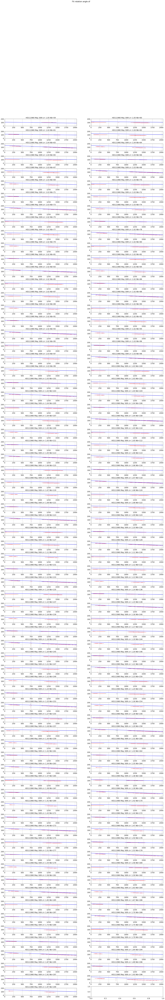

In [151]:
textfilename = os.path.join(inputdir,'star_centroids.txt')
central_positions = np.loadtxt(textfilename)

print all_angles
all_theta=ComputeRotationAngleHessian(all_images2,thex0,they0,all_titles,object_name)
for index in range(len(all_theta)):
    print index,' theta = ',all_theta[index], '\tx0 = ',central_positions[index][1], '\ty0 = ',central_positions[index][0]

### Choose here which rotation angle to apply

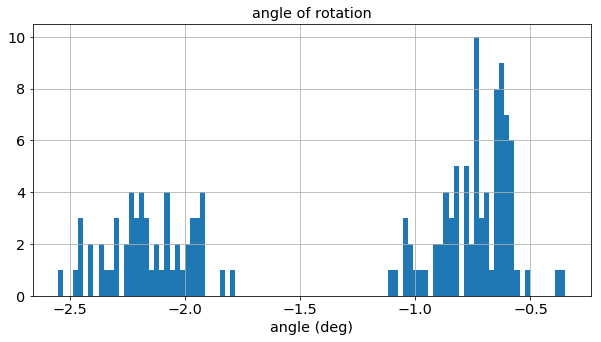

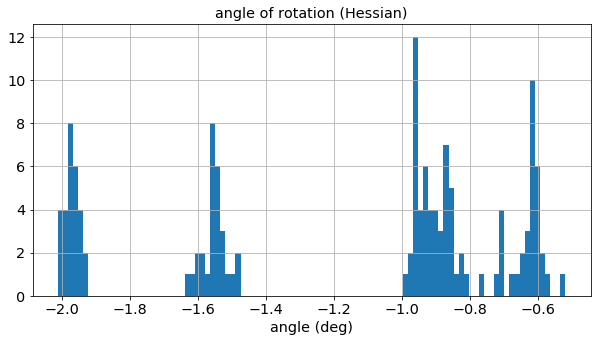

In [152]:
plt.figure(figsize=(10,5))
#hist(x, bins=10, range=None, normed=False, weights=None, cumulative=False, bottom=None, histtype='bar', align='mid', orientation='vertical', rwidth=None, log=False, color=None, label=None, stacked=False, hold=None, data=None, **kwargs)
#n, bins, patches=plt.hist(all_angles,bins=50,range=[-1,.5],histtype='stepfilled')
n, bins, patches=plt.hist(all_angles,bins=100,histtype='stepfilled')
plt.grid(True)
plt.title('angle of rotation')
plt.xlabel('angle (deg)')
plt.figure(figsize=(10,5))
#hist(x, bins=10, range=None, normed=False, weights=None, cumulative=False, bottom=None, histtype='bar', align='mid', orientation='vertical', rwidth=None, log=False, color=None, label=None, stacked=False, hold=None, data=None, **kwargs)
#n, bins, patches=plt.hist(all_angles,bins=50,range=[-1,.5],histtype='stepfilled')
n, bins, patches=plt.hist(all_theta,bins=100,histtype='stepfilled')
plt.grid(True)
plt.title('angle of rotation (Hessian)')
plt.xlabel('angle (deg)')

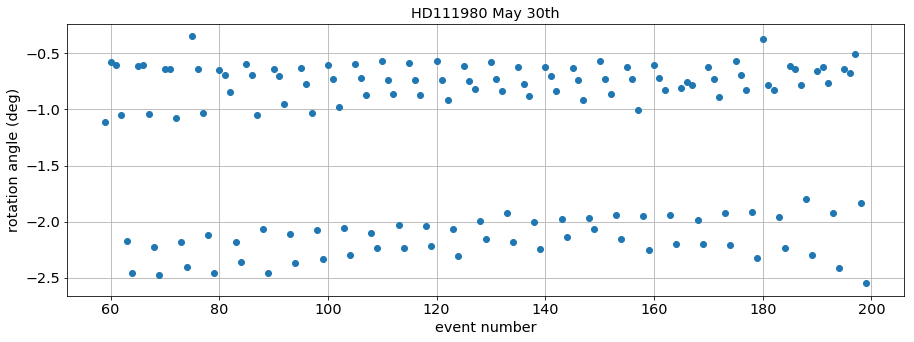

In [153]:
plt.figure(figsize=(15,5))
plt.plot(indexes_files,all_angles,'o')
plt.grid(True)
plt.ylabel('rotation angle (deg)')
plt.xlabel('event number')
plt.title(object_name)
figfilename=os.path.join(dir_top_images,'rotationvsevnum.pdf')
plt.savefig(figfilename) 

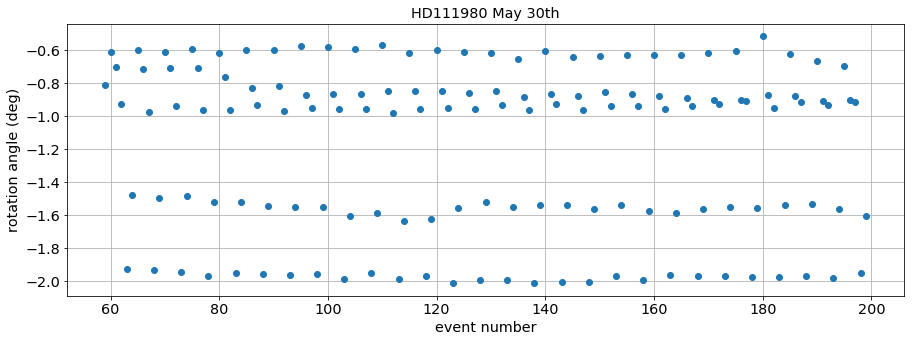

In [154]:
plt.figure(figsize=(15,5))
plt.plot(indexes_files,all_theta,'o')
plt.grid(True)
plt.ylabel('rotation angle (deg)')
plt.xlabel('event number')
plt.title(object_name)
figfilename=os.path.join(dir_top_images,'rotationvsevnum_hessian.pdf')
plt.savefig(figfilename) 

Avec la méthode Hessienne, on voit qu'on obtient des séries de 5 points : une première qui monte, une deuxième plate (donc la bonne hauteur de l'image en y ?) et trois descendantes.

## Now turn the images accordingly

In [155]:
def TurnTheImages(all_images,all_angles,all_titles,object_name,dir_top_images):
    """
    TurnTheImages
    =============
    
    input:
    ------
    all_images:
    all_angles:
    
    
    output:
    ------
    all_rotated_images
    
    """
    NBIMAGES=len(all_images)
    NBIMGPERROW=2
    MAXIMGROW=int(NBIMAGES/NBIMGPERROW)+1
    
    all_rotated_images = []

    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,3*MAXIMGROW))
    for index in np.arange(0,NBIMAGES):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        
        image=all_images[index]    
        angle=all_angles[index]    
        data=np.copy(image)
        
        rotated_image=ndimage.interpolation.rotate(data,angle)
        
        all_rotated_images.append(rotated_image)
        
        im=axarr[iy,ix].imshow(rotated_image,origin='lower',cmap='rainbow',vmin=0,vmax=800)
        #im=axarr[iy,ix].plot(x_new,y_new,'b-')
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(color='white', ls='solid')
        
        axarr[iy,ix].grid(True)
        
    title='Rotated images for '.format(object_name)    
    plt.suptitle(title,size=16)
    
    figfilename=os.path.join(dir_top_images,'rotated_images.pdf')
    plt.savefig(figfilename)  
    
    return all_rotated_images

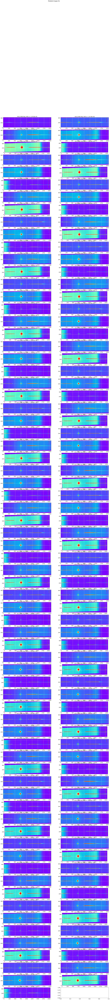

In [156]:
# J'utilise les angles qui viennent de la méthode Hessienne ici
turned_images=TurnTheImages(all_images,all_theta,all_titles,object_name,dir_top_images) #same rotation for each image

## Check rotation

In case of bad rotation, check by eye

In [157]:
sel=4

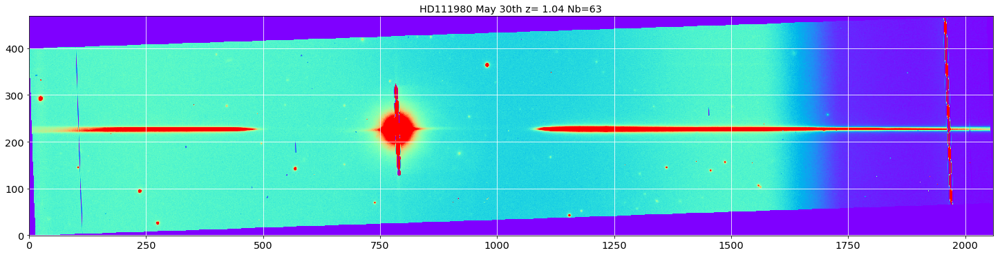

In [158]:
plt.figure(figsize=(25,10))
plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=1000)
plt.grid(True)
plt.title(all_titles[sel])
plt.grid(color='white', ls='solid')
figfilename=os.path.join(dir_top_images,'rotated_image_sample.pdf')
plt.savefig(figfilename)  

array([ 0.00730179,  0.00560593, -0.01081282, -0.01345528,  0.05722246,
        0.05738796,  0.03061134,  0.00780665,  0.04048473,  0.03928253,
        0.05723064,  0.03964216,  0.00659864,  0.00104004,  0.05171006,
        0.03671669,  0.0142651 ,  0.03200117, -0.00812606,  0.05710227,
        0.03919867,  0.02700201,  0.00985227,  0.05352437,  0.05674999,
        0.04884767,  0.01980766,  0.01157909,  0.00243158,  0.05699889,
        0.07283208,  0.00795403,  0.01514068,  0.01324475,  0.05070009,
        0.04093189,  0.0061587 ,  0.00674415,  0.00450109,  0.05940854,
        0.04948051,  0.01128682, -0.00733082, -0.01849162,  0.06141684,
        0.07088065,  0.02347598,  0.03567459,  0.00135022,  0.05293176,
        0.04484322,  0.00326849,  0.01075818,  0.03288302,  0.06129786,
        0.05963978,  0.04155687,  0.00822554,  0.00865497,  0.05773127,
        0.05692388,  0.02189412,  0.01917634, -0.021719  ,  0.06087945,
        0.0519362 ,  0.01028576,  0.00770908,  0.03583854,  0.06

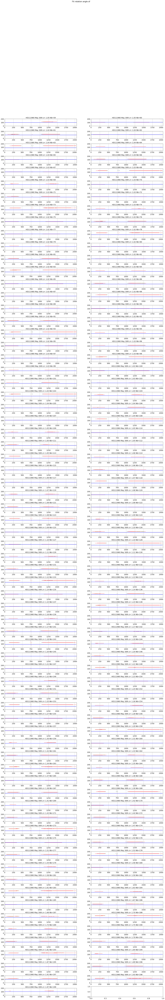

In [159]:
image_sel=np.copy(turned_images[sel])
y0=they0[sel]
x0=thex0[sel]

region=np.copy(image_sel[y0-width_cut:y0+width_cut,:])
data=np.copy(region)

ComputeRotationAngleHessian(turned_images,thex0,they0,all_titles,object_name)

In [164]:
sorted_files

array(['cut_fitsimages/cutimg_20170530_059.fits',
       'cut_fitsimages/cutimg_20170530_060.fits',
       'cut_fitsimages/cutimg_20170530_061.fits',
       'cut_fitsimages/cutimg_20170530_062.fits',
       'cut_fitsimages/cutimg_20170530_063.fits',
       'cut_fitsimages/cutimg_20170530_064.fits',
       'cut_fitsimages/cutimg_20170530_065.fits',
       'cut_fitsimages/cutimg_20170530_066.fits',
       'cut_fitsimages/cutimg_20170530_067.fits',
       'cut_fitsimages/cutimg_20170530_068.fits',
       'cut_fitsimages/cutimg_20170530_069.fits',
       'cut_fitsimages/cutimg_20170530_070.fits',
       'cut_fitsimages/cutimg_20170530_071.fits',
       'cut_fitsimages/cutimg_20170530_072.fits',
       'cut_fitsimages/cutimg_20170530_073.fits',
       'cut_fitsimages/cutimg_20170530_074.fits',
       'cut_fitsimages/cutimg_20170530_075.fits',
       'cut_fitsimages/cutimg_20170530_076.fits',
       'cut_fitsimages/cutimg_20170530_077.fits',
       'cut_fitsimages/cutimg_20170530_078.fits',


In [165]:
newfullfilenames=[]
for idx,file in np.ndenumerate(sorted_files):
    short_infilename=file.split("/")[1]
    short_partfilename=re.findall('^cutimg_(.*)',short_infilename)
    short_outfilename='rotimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)

In [166]:
newfullfilenames

['./rotated_fitsimages/rotimg_20170530_059.fits',
 './rotated_fitsimages/rotimg_20170530_060.fits',
 './rotated_fitsimages/rotimg_20170530_061.fits',
 './rotated_fitsimages/rotimg_20170530_062.fits',
 './rotated_fitsimages/rotimg_20170530_063.fits',
 './rotated_fitsimages/rotimg_20170530_064.fits',
 './rotated_fitsimages/rotimg_20170530_065.fits',
 './rotated_fitsimages/rotimg_20170530_066.fits',
 './rotated_fitsimages/rotimg_20170530_067.fits',
 './rotated_fitsimages/rotimg_20170530_068.fits',
 './rotated_fitsimages/rotimg_20170530_069.fits',
 './rotated_fitsimages/rotimg_20170530_070.fits',
 './rotated_fitsimages/rotimg_20170530_071.fits',
 './rotated_fitsimages/rotimg_20170530_072.fits',
 './rotated_fitsimages/rotimg_20170530_073.fits',
 './rotated_fitsimages/rotimg_20170530_074.fits',
 './rotated_fitsimages/rotimg_20170530_075.fits',
 './rotated_fitsimages/rotimg_20170530_076.fits',
 './rotated_fitsimages/rotimg_20170530_077.fits',
 './rotated_fitsimages/rotimg_20170530_078.fits',


### Save outputfilename

In [167]:
for idx,file in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=turned_images[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(file,overwrite=True)

In [168]:
!ls -l rotated_fitsimages

total 2006864
-rw-r--r--  1 dagoret-campagnesylvie  staff  7058880 Jun  7 13:10 rotimg_20170530_059.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  6940800 Jun  7 13:10 rotimg_20170530_060.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  6992640 Jun  7 13:10 rotimg_20170530_061.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7128000 Jun  7 13:10 rotimg_20170530_062.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7741440 Jun  7 13:10 rotimg_20170530_063.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7470720 Jun  7 13:10 rotimg_20170530_064.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  6940800 Jun  7 13:10 rotimg_20170530_065.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7009920 Jun  7 13:10 rotimg_20170530_066.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7165440 Jun  7 13:10 rotimg_20170530_067.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7741440 Jun  7 13:10 rotimg_20170530_068.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7470720 Jun  7 13:10 rotimg_201